In [1]:
import mne
import scipy
import matplotlib.pyplot as plt
import seaborn as sns
import os
import re
import numpy as np
from colour import Color
from mne.preprocessing import ICA
from mne.time_frequency import tfr_morlet
from matplotlib.gridspec import GridSpec
import pyprep
from scipy import stats
from scipy.stats import zscore
import pandas as pd
from statannot import add_stat_annotation
import matplotlib.pyplot as plt
from mne_connectivity import spectral_connectivity_epochs

plt.rcParams["font.family"] = "Arial"
mne.__version__

'1.3.1'

In [2]:
n_part = 29 # number of participants

In [3]:
def get_stat(var): # get median and 25th, 75th percentiles
    print(f'{np.median(var):.2f} [{np.percentile(var, 25):.2f}-{np.percentile(var, 75):.2f}]')

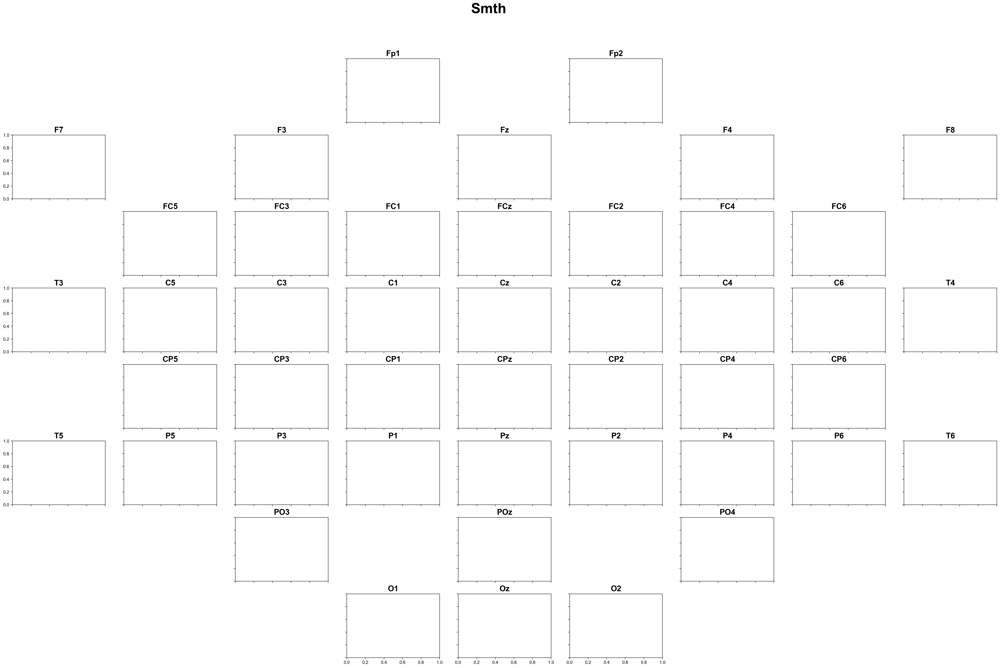

In [4]:
fs = 500
electrodes = ['Fp1', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8', 'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'T3', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'T4', 'TP9', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP4', 'CP6', 'TP10', 'T5', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 'T6', 'PO3', 'POz', 'PO4', 'O1', 'Oz', 'O2']

dict_rows = {
    'Fp':0,
    'F':1,
    'FC':2,
    'T':-1,
    'TP':-1,
    'C':3,
    'CP':4,
    'P':5,
    'PO':6,
    'O':7,
}

dict_cols = {
    '9':-1,
    '7':0,
    '5':1,
    '3':2,
    '1':3,
    'z':4,
    '2':5,
    '4':6,
    '6':7,
    '8':8, 
    '10':-1
}

cols_seq = [dict_cols[re.split('(\d+)', i)[1]] if 'z' not in i else dict_cols[i[-1]] for i in electrodes]
rows_seq = [dict_rows[re.split('(\d+)', i)[0]] if 'z' not in i else dict_rows[i[:-1]] for i in electrodes]

cols_seq[electrodes.index('T3')] = 0
rows_seq[electrodes.index('T3')] = 3
cols_seq[electrodes.index('T4')] = 8
rows_seq[electrodes.index('T4')] = 3

cols_seq[electrodes.index('T5')] = 0
rows_seq[electrodes.index('T5')] = 5
cols_seq[electrodes.index('T6')] = 8
rows_seq[electrodes.index('T6')] = 5

nrows = max(rows_seq)+1
ncols = max(cols_seq)+1

figure, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(40, 25), sharex=True, sharey=True, dpi=200)

for e in range(len(electrodes)):
    if electrodes[e] in ['TP9', 'TP10']:
        continue
    axes[rows_seq[e]][cols_seq[e]].set_title(electrodes[e], fontsize=18, fontweight='bold')
    
pairs = [str(rows_seq[i])+str(cols_seq[i]) for i in range(len(electrodes))]
    
for row in range(nrows):
    for col in range(ncols):
        if str(row) + str(col) not in pairs:
            axes[row][col].set_axis_off()

# figure.subplots_adjust(right=0.8)
# cbar_ax = figure.add_axes([0.83, 0.4, 0.01, 0.3])
# cbar = figure.colorbar(cp, cax=cbar_ax)
# cbar.ax.set_title(mode, fontsize=18)
            
plt.suptitle('Smth', fontsize=32, y=0.95, fontweight='bold')
plt.show()

# Long Tactile Stimulation and Tactile Imagery wavelets

In [5]:
stim_long_w = np.load('data_for_final_pics/long_wavelets/learning.npy')
im_long_w = np.load('data_for_final_pics/long_wavelets/imagery.npy')
mu_ind_values = np.genfromtxt('data_for_final_pics/long_wavelets/mu_freq.csv')
beta_ind_values = np.genfromtxt('data_for_final_pics/long_wavelets/beta_freq.csv')

times = np.linspace(-1, 9, 501)
freqs = np.genfromtxt('data_for_final_pics/long_wavelets/freqs.csv')

vmin, vmax = -40, 40

Text(0.5, 0.9, 'Sensorimotor (C3, CP3) wavelets and individual mu and beta frequencies (red)')

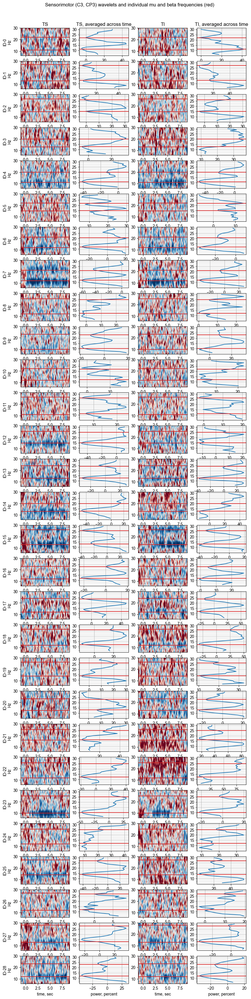

In [6]:
left_sm = [electrodes.index(i) for i in ['C3', 'CP3']]

fig, axes = plt.subplots(nrows=n_part, ncols=4, figsize=(10, n_part*1.5), dpi=100)

for i in range(n_part):
    axes[i][0].pcolormesh(times, freqs, np.mean(stim_long_w[i, left_sm], axis=0)*100, vmin=-80, vmax=80, cmap='RdBu_r', shading='gouraud')
    axes[i][1].plot(np.mean(stim_long_w[i, left_sm], axis=(0, -1))*100, freqs)
    axes[i][1].set_yticks(range(10, 31, 5), minor=False)
    axes[i][1].set_yticks(freqs, minor=True)
    axes[i][1].grid(which='major', alpha=0.9)
    axes[i][1].grid(which='minor', alpha=0.4)
    
    axes[i][2].pcolormesh(times, freqs, np.mean(im_long_w[i, left_sm], axis=0)*100, vmin=-80, vmax=80, cmap='RdBu_r', shading='gouraud')
    axes[i][3].plot(np.mean(im_long_w[i, left_sm], axis=(0, -1))*100, freqs)
    axes[i][3].set_yticks(range(10, 31, 5), minor=False)
    axes[i][3].set_yticks(freqs, minor=True)
    axes[i][3].grid(which='major', alpha=0.9)
    axes[i][3].grid(which='minor', alpha=0.4)
    
    for j in range(4):
        axes[i][j].axhline(mu_ind_values[i], color='tab:red')
        axes[i][j].axhline(beta_ind_values[i], color='tab:red')
    
    axes[i][0].set_ylabel('ID-'+str(i)+'\nHz')
    
axes[0][0].set_title('TS')
axes[0][1].set_title('TS, averaged across time')
axes[0][2].set_title('TI')
axes[0][3].set_title('TI, averaged across time')

axes[-1][0].set_xlabel('time, sec')
axes[-1][1].set_xlabel('power, percent')
axes[-1][2].set_xlabel('time, sec')
axes[-1][3].set_xlabel('power, percent')

plt.suptitle('Sensorimotor (C3, CP3) wavelets and individual mu and beta frequencies (red)', y=0.9)

In [7]:
r_spectra = np.genfromtxt('data_for_final_pics/long_wavelets/rest_spectra.csv')
r_spectra_freqs = np.genfromtxt('data_for_final_pics/long_wavelets/rest_spectra_freqs.csv')

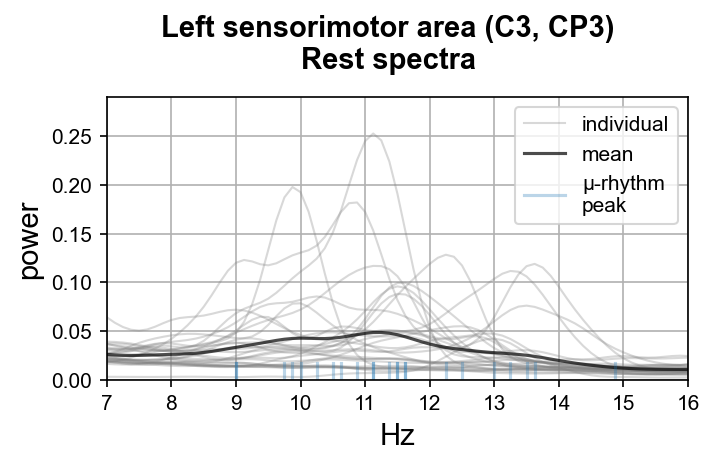

In [8]:
fig, axes = plt.subplots(figsize=(5, 2.5), dpi=150)

axes.plot(r_spectra_freqs, r_spectra.T, color='tab:grey', alpha=0.3, linewidth=1, label='individual')
axes.plot(r_spectra_freqs, r_spectra.mean(0), color='black', alpha=0.7, linewidth=1.5, label='mean')

h, l = axes.get_legend_handles_labels()
h, l = h[-2:], l[-2:]
plt.legend(h, l)

for i in r_spectra_freqs[np.argmax(np.array(r_spectra)[:, np.where(r_spectra_freqs==8)[0][0]:np.where(r_spectra_freqs==15)[0][0]], axis=1)] + 8:
    if i == 8:
        continue
    plt.axvline(i, 0, 0.06, color='tab:blue', alpha=0.3, label='µ-rhythm\npeak')

h2, l2 = axes.get_legend_handles_labels()
h2, l2 = [h2[-1]], [l2[-1]]

h, l = h+h2, l+l2
plt.legend(h, l)

plt.xticks(range(1, 31))
plt.xlim(7, 16)
plt.ylim(0, 0.29)
plt.ylabel('power', fontsize=14)
plt.xlabel('Hz', fontsize=14)

suptitle = plt.suptitle('Left sensorimotor area (C3, CP3)\nRest spectra', fontsize=14, fontweight='bold', y=1.1)
plt.savefig('pics/rest_spectra.jpg', bbox_extra_artists=[suptitle], bbox_inches='tight')
plt.grid()

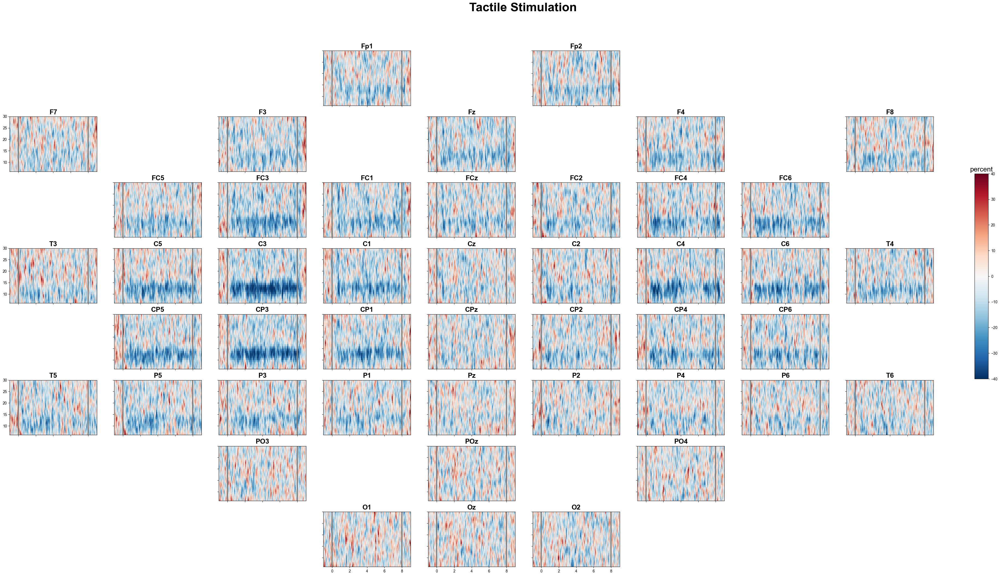

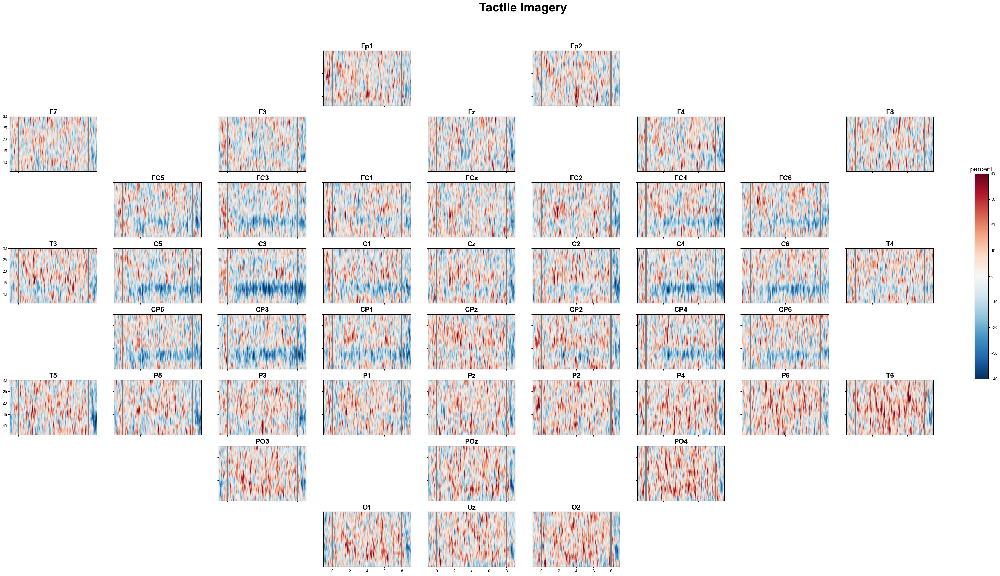

In [9]:
for tfr, label in zip([stim_long_w, im_long_w], ['Tactile Stimulation', 'Tactile Imagery']):

    figure, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(50, 25), sharex=True, sharey=True, dpi=100)

    for e in range(len(electrodes)):
        if electrodes[e] in ['TP9', 'TP10']:
            continue
        cp = axes[rows_seq[e]][cols_seq[e]].pcolormesh(times, freqs, np.median(tfr[:, e], axis=0)*100, vmin=vmin, vmax=vmax, cmap='RdBu_r', shading='gouraud') # plt.cm.jet
        axes[rows_seq[e]][cols_seq[e]].set_title(electrodes[e], fontsize=18, fontweight='bold')
        axes[rows_seq[e]][cols_seq[e]].axvline(0, color='tab:gray', linewidth=3)
        axes[rows_seq[e]][cols_seq[e]].axvline(8, color='tab:gray', linewidth=3)

    pairs = [str(rows_seq[i])+str(cols_seq[i]) for i in range(len(electrodes))]

    for row in range(nrows):
        for col in range(ncols):
            if str(row) + str(col) not in pairs:
                axes[row][col].set_axis_off()

    figure.subplots_adjust(right=0.8)
    cbar_ax = figure.add_axes([0.83, 0.4, 0.01, 0.3])
    cbar = figure.colorbar(cp, cax=cbar_ax)
    cbar.ax.set_title('percent', fontsize=18)

    suptitle = plt.suptitle(label, fontsize=32, y=0.95, fontweight='bold')
    plt.savefig('pics/'+label+'_median_long_wavelets.jpg', bbox_extra_artists=[suptitle], bbox_inches='tight')
    plt.show()

In [10]:
left_sm = [i for i in range(len(electrodes)) if electrodes[i] in ['C3', 'CP3']] # left sensorimotor area

In [11]:
from scipy.ndimage import convolve1d

learning_ci = np.array([np.median(stim_long_w[i, left_sm, (np.where(freqs == mu_ind_values[i])[0][0]-1):(np.where(freqs == mu_ind_values[i])[0][0]+2)], axis=(0, 1)) for i in range(n_part)])
imagery_ci = np.array([np.median(im_long_w[i, left_sm, (np.where(freqs == mu_ind_values[i])[0][0]-1):(np.where(freqs == mu_ind_values[i])[0][0]+2)], axis=(0, 1)) for i in range(n_part)])

learning_ci *=100
imagery_ci *=100

# I smooth curves as due to median they look very noisy
N = 30 
learning_ci = convolve1d(learning_ci, np.ones(N)/N, axis=-1)
imagery_ci = convolve1d(imagery_ci, np.ones(N)/N, axis=-1)

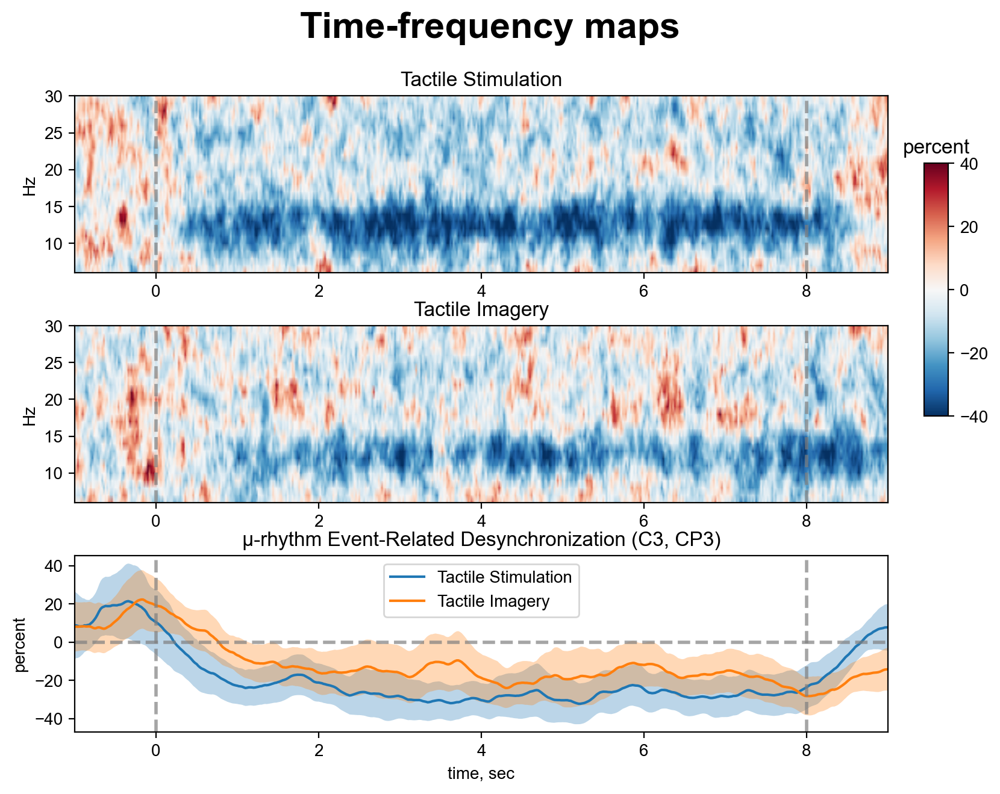

In [12]:
figure, axes = plt.subplots(nrows=3, ncols=1, figsize=(10, 7), dpi=200)

cp = axes[0].pcolormesh(np.linspace(-1, 9, 501), freqs, np.median(stim_long_w[:, left_sm], axis=(0, 1))*100, vmin=vmin, vmax=vmax, cmap='RdBu_r', shading='gouraud', label='TS')
cp = axes[1].pcolormesh(np.linspace(-1, 9, 501), freqs, np.median(im_long_w[:, left_sm], axis=(0, 1))*100, vmin=vmin, vmax=vmax, cmap='RdBu_r', shading='gouraud', label='TI')

figure.subplots_adjust(right=0.8)
cbar_ax = figure.add_axes([0.83, 0.5, 0.02, 0.3])
cbar = figure.colorbar(cp, cax=cbar_ax)
cbar.ax.set_title('percent')

axes[0].set_title('Tactile Stimulation')
axes[1].set_title('Tactile Imagery')

for data_ci, name in zip([learning_ci, imagery_ci], ['Tactile Stimulation', 'Tactile Imagery']):
    axes[2].plot(np.linspace(-1, 9, 501), data_ci.mean(axis=0), label=name)
    ci = 1.96 * np.std(data_ci, axis=0)/np.sqrt(len(data_ci)) # confidence interval
    axes[2].fill_between(np.linspace(-1, 9, 501), (data_ci.mean(axis=0)-ci), (data_ci.mean(axis=0)+ci), alpha=.3)
axes[2].set_xlim(-1, 9)
    
for i in range(3):
    axes[i].axvline(0, color='tab:gray', linewidth=2, alpha=0.7, linestyle='--')
    axes[i].axvline(8, color='tab:gray', linewidth=2, alpha=0.7, linestyle='--')

axes[0].set_ylabel('Hz')
axes[1].set_ylabel('Hz')
axes[2].set_ylabel('percent')
axes[2].set_title('µ-rhythm Event-Related Desynchronization (C3, CP3)')
    
axes[2].set_xlabel('time, sec')
axes[2].axhline(0, color='tab:gray', linewidth=2, alpha=0.7, linestyle='--')
axes[2].legend()

plt.subplots_adjust(hspace=0.3)
suptitle = plt.suptitle('Time-frequency maps', fontsize=22, fontweight='bold', x=0.47)

plt.savefig('pics/tfr.jpg', bbox_inches='tight', bbox_extra_artists=[suptitle])

In [13]:
learning_all_e = np.array([np.median(stim_long_w[i, :, (np.where(freqs == mu_ind_values[i])[0][0]-1):(np.where(freqs == mu_ind_values[i])[0][0]+2), 50:-50], axis=(1, 2)) for i in range(n_part)])
imagery_all_e = np.array([np.median(im_long_w[i, :, (np.where(freqs == mu_ind_values[i])[0][0]-1):(np.where(freqs == mu_ind_values[i])[0][0]+2), 50:-50], axis=(1, 2)) for i in range(n_part)])

learning_all_e_beta = np.array([np.median(stim_long_w[i, :, (np.where(freqs == beta_ind_values[i])[0][0]-1):(np.where(freqs == beta_ind_values[i])[0][0]+2), 50:-50], axis=(1, 2)) for i in range(n_part)])
imagery_all_e_beta = np.array([np.median(im_long_w[i, :, (np.where(freqs == beta_ind_values[i])[0][0]-1):(np.where(freqs == beta_ind_values[i])[0][0]+2), 50:-50], axis=(1, 2)) for i in range(n_part)])

In [14]:
info = mne.create_info(electrodes, 500, ch_types='eeg', verbose=None)
montage = mne.channels.make_standard_montage('standard_1020')
info.set_montage(montage)

<Info | 8 non-empty values
 bads: []
 ch_names: Fp1, Fp2, F7, F3, Fz, F4, F8, FC5, FC3, FC1, FCz, FC2, FC4, FC6, ...
 chs: 47 EEG
 custom_ref_applied: False
 dig: 50 items (3 Cardinal, 47 EEG)
 highpass: 0.0 Hz
 lowpass: 250.0 Hz
 meas_date: unspecified
 nchan: 47
 projs: []
 sfreq: 500.0 Hz
>

<ipython-input-15-5928b3bc7792>:21: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


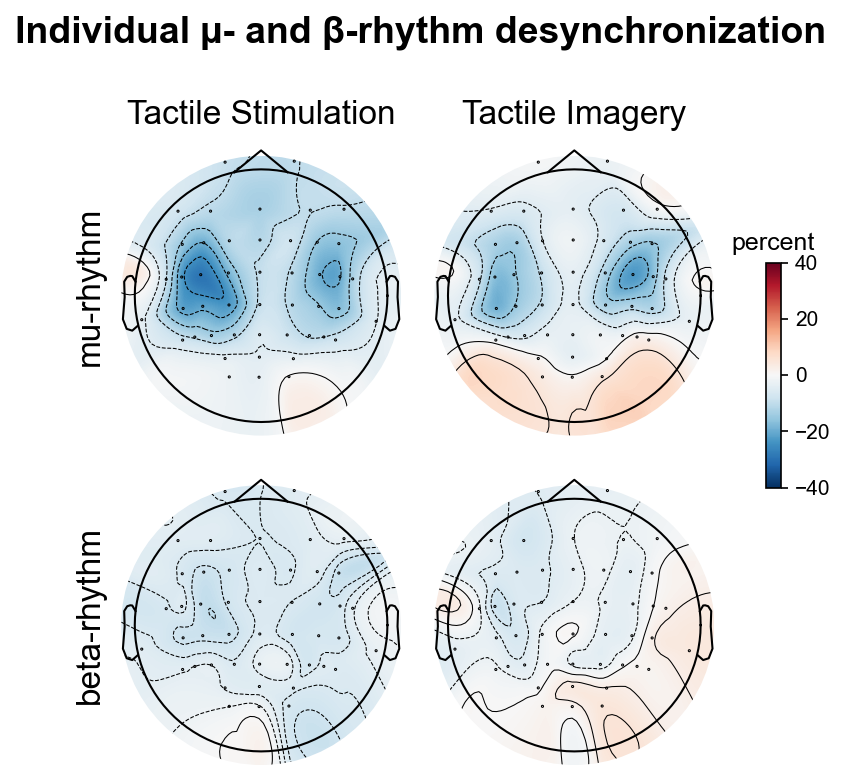

In [15]:
figure, axes = plt.subplots(nrows=2, ncols=2, dpi=150, figsize=(5, 5), sharex=True, sharey=True)

mne.viz.plot_topomap(np.median(learning_all_e*100, axis=0), info, axes=axes[0][0], vlim=(vmin, vmax), show=False)
im, cm = mne.viz.plot_topomap(np.median(imagery_all_e*100, axis=0), info, axes=axes[0][1], vlim=(vmin, vmax), show=False)

mne.viz.plot_topomap(np.median(learning_all_e_beta*100, axis=0), info, axes=axes[1][0], vlim=(vmin, vmax), show=False)
im, cm = mne.viz.plot_topomap(np.median(imagery_all_e_beta*100, axis=0), info, axes=axes[1][1], vlim=(vmin, vmax), show=False)

figure.subplots_adjust(right=0.8)
cbar_ax = figure.add_axes([0.96, 0.4, 0.02, 0.3])
cbar = figure.colorbar(im, cax=cbar_ax)
cbar.ax.set_title('percent')


axes[0][0].set_title('Tactile Stimulation', fontsize=16)
axes[0][0].set_ylabel('mu-rhythm', fontsize=16)
axes[0][1].set_title('Tactile Imagery', fontsize=16)
axes[1][0].set_ylabel('beta-rhythm', fontsize=16)
suptitle = plt.suptitle('Individual µ- and β-rhythm desynchronization', y=1.03, fontsize=18, fontweight='bold')

plt.tight_layout()
plt.subplots_adjust(hspace=0.1, right=0.9)

plt.savefig('pics/chosen_electrodes_erp.jpg', bbox_inches='tight', bbox_extra_artists=[suptitle])

In [16]:
cond = np.array([1]) # bad_imaginers
not_cond = np.array([i for i in range(n_part) if i not in cond]) # good imaginers
# we excluded 1 outlier for LI calcutations

In [17]:
left_sm = [electrodes.index(i) for i in ['C3']]
right_sm = [electrodes.index(i) for i in ['C4']]

learn_li = ((learning_all_e[:, right_sm].sum(-1) - learning_all_e[:, left_sm].sum(-1)) / (learning_all_e[:, left_sm].sum(-1) + learning_all_e[:, right_sm].sum(-1)))
im_li = ((imagery_all_e[:, right_sm].sum(-1) - imagery_all_e[:, left_sm].sum(-1)) / (imagery_all_e[:, left_sm].sum(-1) + imagery_all_e[:, right_sm].sum(-1)))

df_li = pd.DataFrame(
    {'learning':learn_li[not_cond],
     'imagery':im_li[not_cond],
    }
)

df_li = df_li.melt()
df_li['id'] = list(range(len(not_cond))) *2

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

Using zero_method  wilcox
learning v.s. imagery: Wilcoxon test (paired samples), P_val=1.375e-01 stat=1.370e+02


Text(0.5, 1.0, 'Lateralization index, $\\frac{ERD_{C4} - ERD_{C3}}{ERD_{C4} + ERD_{C3}}$')

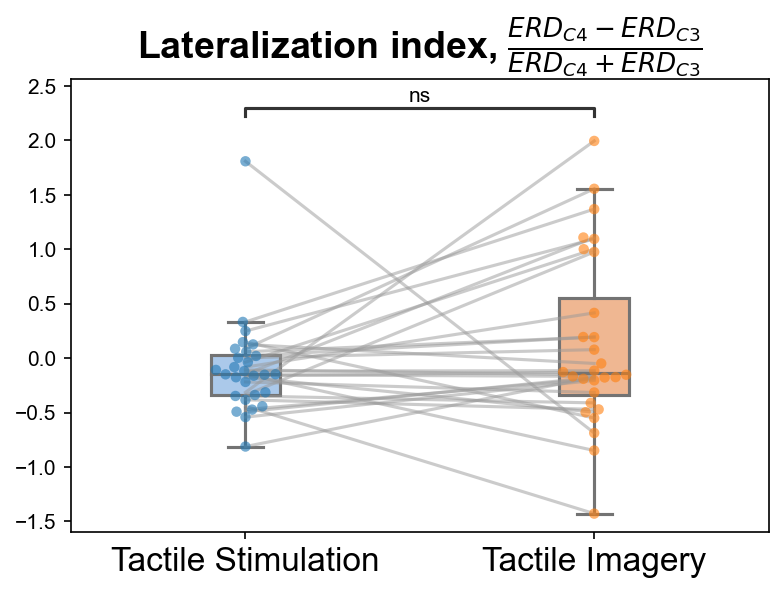

In [18]:
plt.figure(dpi=150)

sns.boxplot(x="variable", y="value", data=df_li, palette='pastel', showfliers=False, width=0.2)
g = sns.swarmplot(x="variable", y="value", data=df_li, alpha=0.6)
sns.lineplot(x="variable", y="value", data=df_li, hue='id', palette=sns.color_palette(["#999999"]*len(not_cond)), alpha=0.5, estimator=None, legend=False)

plt.xlabel('')
plt.ylabel('')

test_results = add_stat_annotation(g, data=df_li, x="variable", y="value",
                                           box_pairs=[('learning', 'imagery')], comparisons_correction=None,
                                           test='Wilcoxon', text_format='star',
                                           loc='inside', verbose=2)
g.set_xticklabels(['Tactile Stimulation', 'Tactile Imagery'], rotation=0, size=16)
plt.title('Lateralization index, $\\frac{ERD_{C4} - ERD_{C3}}{ERD_{C4} + ERD_{C3}}$', fontsize=18, fontweight='bold')

In [19]:
left_sm = [electrodes.index(i) for i in ['C3', 'CP3']]

mu_power_imagery = [np.median(im_long_w[i, left_sm, (np.where(freqs == mu_ind_values[i])[0][0]-1):(np.where(freqs == mu_ind_values[i])[0][0]+2), 50:-50]) for i in range(n_part)]
mu_power_learning = [np.median(stim_long_w[i, left_sm, (np.where(freqs == mu_ind_values[i])[0][0]-1):(np.where(freqs == mu_ind_values[i])[0][0]+2), 50:-50]) for i in range(n_part)]
mu_power_imagery = np.array(mu_power_imagery)
mu_power_learning = np.array(mu_power_learning)
mu_power_imagery *= 100
mu_power_learning *= 100

a, b = np.polyfit(mu_power_learning, mu_power_imagery, deg=1)
a, b

(0.7755320661909151, 2.6253364328489726)

<Figure size 1080x1152 with 0 Axes>

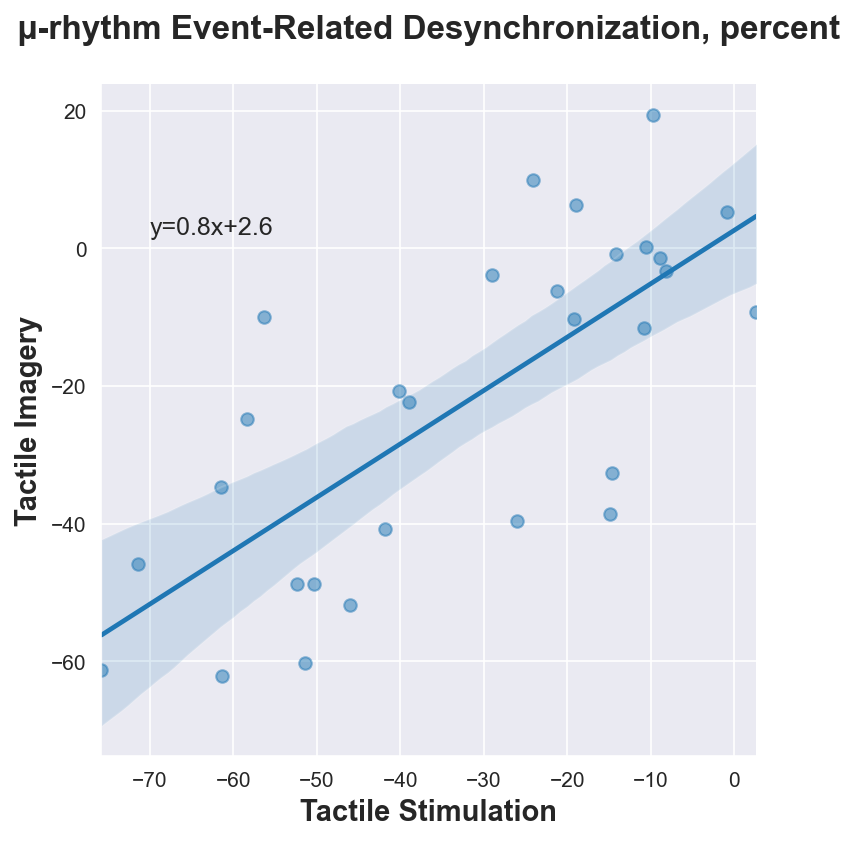

In [20]:
df_mu = pd.DataFrame({'learning':mu_power_learning, 'imagery':mu_power_imagery})
plt.figure(figsize=(15,16))

sns.set_style("darkgrid")
regplot = sns.lmplot(x='learning', y='imagery', data=df_mu, fit_reg=True, ci=95, n_boot=1000, scatter_kws={'alpha':0.5})

# Get the x and y values of the regression line
x, y = regplot.ax.get_lines()[0].get_data()

# Calculate the slope and intercept of the line
slope, intercept = np.polyfit(x, y, 1)

# Add the regression equation as a text on the plot
plt.text(-70, 2, "y={0:.1f}x+{1:.1f}".format(slope,intercept), fontsize=12)

plt.xlabel('Tactile Stimulation', fontsize=14, fontweight='bold')
plt.ylabel('Tactile Imagery', fontsize=14, fontweight='bold')
plt.title('µ-rhythm Event-Related Desynchronization, percent', fontsize=16, fontweight='bold', y=1.05)

regplot.fig.set_dpi(150)
plt.savefig('pics/correlation_ts_ti.jpg', bbox_inches='tight')
plt.show()
sns.set_style("ticks")

In [21]:
stats.spearmanr(mu_power_learning, mu_power_imagery) 
# Spearman correlation statistic for mu-ERD during TS and mu-ERD during TI

SignificanceResult(statistic=0.7310344827586206, pvalue=6.669436578749833e-06)

Mu-ERD during TS is greater than during TI

In [22]:
print('Mu-ERD during TS VS mu-ERD during TI (left sensorimotor area):', stats.wilcoxon(mu_power_imagery, mu_power_learning))
print('\nTS:')
get_stat(mu_power_learning)
print('\nTI:')
get_stat(mu_power_imagery)

Mu-ERD during TS VS mu-ERD during TI (left sensorimotor area): WilcoxonResult(statistic=88.0, pvalue=0.004106286913156509)

TS:
-25.98 [-51.46--14.14]

TI:
-20.73 [-40.84--3.31]


During TS, contra- and ipsilateral mu-ERD differ

During TI, contra- and ipsilateral mu-ERD do not differ

In [23]:
print('TS, Contra mu-ERD VS Ipsi mu-ERD:', stats.wilcoxon(learning_all_e[:, left_sm].mean(axis=1), learning_all_e[:, right_sm].mean(axis=1)))

print('Contra mu-ERD, TS:')
get_stat(learning_all_e[:, left_sm].mean(axis=1))
print('Ipsi mu-ERD, TS:')
get_stat(learning_all_e[:, right_sm].mean(axis=1))

print()
print('TI, Contra mu-ERD VS Ipsi mu-ERD:', stats.wilcoxon(imagery_all_e[:, left_sm].mean(axis=1), imagery_all_e[:, right_sm].mean(axis=1)))

print('Contra mu-ERD, TI:')
get_stat(imagery_all_e[:, left_sm].mean(axis=1))
print('Ipsi mu-ERD, TI:')
get_stat(imagery_all_e[:, right_sm].mean(axis=1))

TS, Contra mu-ERD VS Ipsi mu-ERD: WilcoxonResult(statistic=107.0, pvalue=0.01574459671974182)
Contra mu-ERD, TS:
-0.26 [-0.51--0.14]
Ipsi mu-ERD, TS:
-0.19 [-0.34--0.11]

TI, Contra mu-ERD VS Ipsi mu-ERD: WilcoxonResult(statistic=165.0, pvalue=0.2652079239487648)
Contra mu-ERD, TI:
-0.21 [-0.41--0.03]
Ipsi mu-ERD, TI:
-0.23 [-0.39--0.02]


# ERP

In [24]:
rest_erp = np.load('data_for_final_pics/erp/rest.npy')
im_erp = np.load('data_for_final_pics/erp/imagery.npy')

In [25]:
es_p100_left = [
    electrodes.index(i) for i in ['P1', 'CP3', 'P5', 'P3']
]
es_p100_right = [
    electrodes.index(i) for i in ['P2', 'CP4', 'P6','P4']
]
ts_p100 = slice(295, 310)



es_p200_left = [
    electrodes.index(i) for i in ['F3', 'FC1', 'FC3']
]
es_p200_right = [
    electrodes.index(i) for i in ['F4', 'FC2', 'FC4']
]
ts_p200 = slice(355, 370)



es_p300_left = [
    electrodes.index(i) for i in ['C5', 'CP5']
]
es_p300_right = [
    electrodes.index(i) for i in ['C6', 'CP6'] 
]
ts_p300 = slice(395, 410)

In [26]:
info = mne.create_info(electrodes, 500, ch_types='eeg', verbose=None)
montage = mne.channels.make_standard_montage('standard_1020')
info.set_montage(montage)

<Info | 8 non-empty values
 bads: []
 ch_names: Fp1, Fp2, F7, F3, Fz, F4, F8, FC5, FC3, FC1, FCz, FC2, FC4, FC6, ...
 chs: 47 EEG
 custom_ref_applied: False
 dig: 50 items (3 Cardinal, 47 EEG)
 highpass: 0.0 Hz
 lowpass: 250.0 Hz
 meas_date: unspecified
 nchan: 47
 projs: []
 sfreq: 500.0 Hz
>

Not setting metadata
29 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
29 matching events found
No baseline correction applied
0 projection items activated


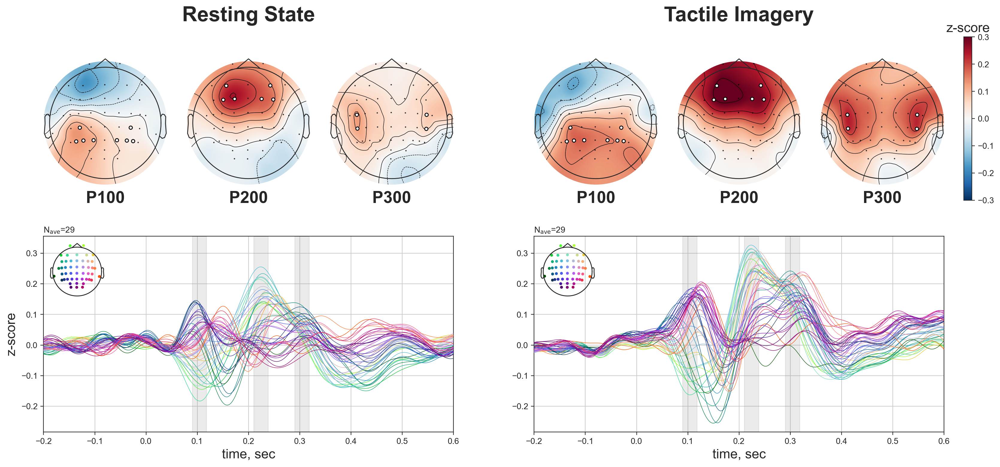

In [27]:
fig = plt.figure(dpi=200, figsize=(20, 8))
gs = GridSpec(nrows=2, ncols=8, figure=fig, width_ratios=[0.15]*3 + [0.05] + [0.15]*3 + [0.01], height_ratios=[0.5, 0.6])

locs = [
    es_p100_left+es_p100_right,
    es_p200_left+es_p200_right,
    es_p300_left+es_p300_right
]

for i, eps in enumerate([rest_erp, im_erp]):
    for j, times in enumerate([ts_p100, ts_p200, ts_p300]):
        ax = fig.add_subplot(gs[0, i*3+j+1*i])
        im, cm = mne.viz.plot_topomap(np.mean(eps[:, :, times], axis=(0,-1)), info, axes=ax,
                                      vlim=(-0.3, 0.3), show=False, mask=np.array([True if e in locs[j] else False for e in range(len(electrodes))]))

        ax.set_xlabel(['P100', 'P200', 'P300'][j], fontsize=20, fontweight='bold')
        
        if (i, j) == (0, 1):
            ax.set_title('Resting State', fontsize=25, fontweight='bold', y=1.2)
            
        if (i, j) == (1, 1):
            ax.set_title('Tactile Imagery', fontsize=25, fontweight='bold', y=1.2)
        
ax = fig.add_subplot(gs[0, -1])
cbar = plt.colorbar(im, cax=ax)
cbar.ax.set_title('z-score', fontsize=16)

axes = [fig.add_subplot(gs[1, :3]), fig.add_subplot(gs[1, 4:-1])]

for i, eps in enumerate([rest_erp, im_erp]):
    
    eps_erp = mne.EpochsArray(eps/1e6, info, tmin=-0.5)
    eps_erp.average().plot(axes=axes[i], show=False)
    
    axes[i].grid()
    
    axes[i].set_xlim(-0.2, 0.6)
    axes[i].set_xlabel('')
    axes[i].set_ylabel('')
    axes[i].set_title('')
    
for i in range(2):
    for j, times in enumerate([ts_p100, ts_p200, ts_p300]):
        axes[i].axvspan(eps_erp.times[times][0], eps_erp.times[times][-1], color='tab:gray', alpha=0.15)
    
axes[0].set_ylabel('z-score', fontsize=16)
axes[0].set_xlabel('time, sec', fontsize=16)
axes[1].set_xlabel('time, sec', fontsize=16)

axes[0].sharey(axes[1])

plt.savefig('pics/erps.jpg', bbox_inches='tight')
plt.show()

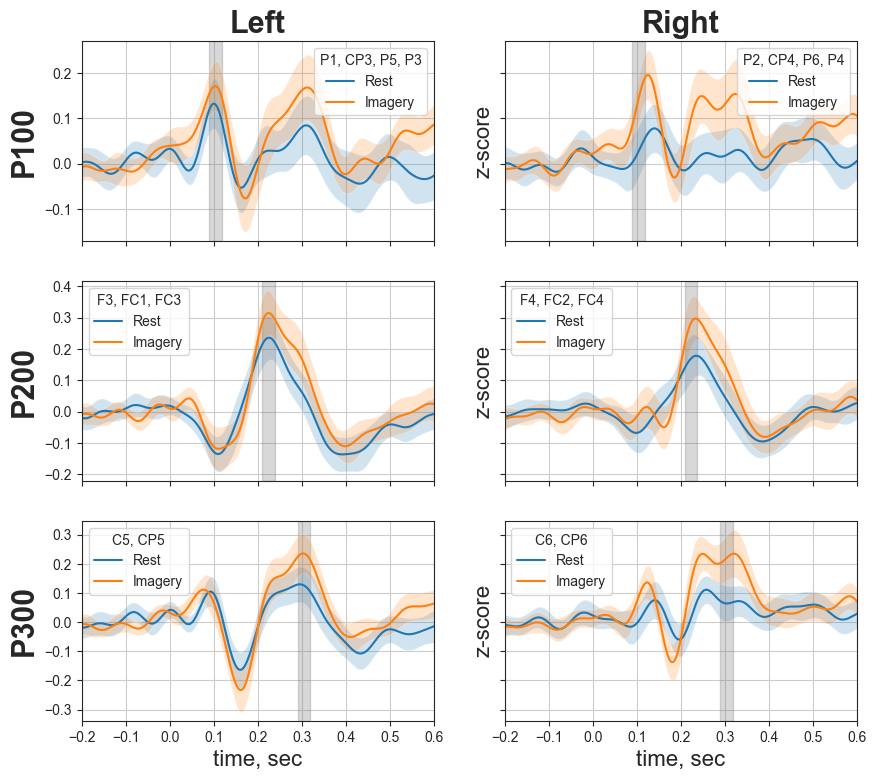

In [28]:
figure, axes = plt.subplots(nrows=3, ncols=2, figsize=(10, 9), dpi=100, sharey='row', sharex=True)

row_names = ['P100', 'P200', 'P300']
col_names = ['Left', 'Right']
times = [ts_p100, ts_p200, ts_p300]

for i in range(2):
    axes[0][i].set_title(col_names[i], fontsize=22, fontweight='bold')
    
for i in range(3):
    axes[i][0].set_ylabel(row_names[i], fontsize=22, fontweight='bold')
    axes[i][1].set_ylabel('z-score', fontsize=16)  

for i, locs in enumerate([[es_p100_left, es_p100_right], [es_p200_left, es_p200_right], [es_p300_left, es_p300_right]]):
    for j, data in enumerate([rest_erp, im_erp]):
        axes[i][0].plot(np.linspace(-0.5, 1, 751), data[:, locs[0]].mean(axis=(0, 1)), label=['Rest', 'Imagery'][j]) #'left: '+', '.join([electrodes[i] for i in locs[0]]))
        axes[i][1].plot(np.linspace(-0.5, 1, 751), data[:, locs[1]].mean(axis=(0, 1)), label=['Rest', 'Imagery'][j])
        
        ci = 1.96 * np.std(data[:, locs[0]].mean(axis=(1)), axis=0)/np.sqrt(len(data)) # confidence interval
        axes[i][0].fill_between(np.linspace(-0.5, 1, 751), (data[:, locs[0]].mean(axis=(0, 1))-ci), (data[:, locs[0]].mean(axis=(0, 1))+ci), alpha=.2)
        
        ci = 1.96 * np.std(data[:, locs[1]].mean(axis=(1)), axis=0)/np.sqrt(len(data)) # confidence interval
        axes[i][1].fill_between(np.linspace(-0.5, 1, 751), (data[:, locs[1]].mean(axis=(0, 1))-ci), (data[:, locs[1]].mean(axis=(0, 1))+ci), alpha=.2)
        
        axes[i][j].axvspan(eps_erp.times[times[i]][0], eps_erp.times[times[i]][-1], color='tab:gray', alpha=0.3)
        
        if i == 0:
            axes[i][0].legend(loc=1, title = ', '.join([electrodes[i] for i in locs[0]]))
            axes[i][1].legend(loc=1, title = ', '.join([electrodes[i] for i in locs[1]]))
        elif i in [1, 2]:
            axes[i][0].legend(loc=2, title = ', '.join([electrodes[i] for i in locs[0]]))
            axes[i][1].legend(loc=2, title = ', '.join([electrodes[i] for i in locs[1]]))
        axes[i][j].grid()
        axes[i][j].set_xlim(-0.2, 0.6)

axes[-1][0].set_xlabel('time, sec', fontsize=16)      
axes[-1][1].set_xlabel('time, sec', fontsize=16)   

plt.savefig('pics/chosen_electrodes_erp.jpg', bbox_inches='tight')
plt.show()

In [29]:
for t in range(250, 501, 5):
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5), dpi=300)
    
    mne.viz.plot_topomap(np.mean(rest_erp[:, :, t-2:t+3], axis=(0,-1)), info, axes=axes[0], vlim=(-0.3, 0.3), show=False)
    mne.viz.plot_topomap(np.mean(im_erp[:, :, t-2:t+3], axis=(0,-1)), info, axes=axes[1], vlim=(-0.3, 0.3), show=False)
    
    axes[0].set_title('Rest', fontsize=16, fontweight='bold')
    axes[1].set_title('Imagery', fontsize=16, fontweight='bold')
    suptitle = plt.suptitle(str(np.round(t/500-0.5, 3))+' sec', fontsize=20)
    
    plt.savefig('for_gif/'+str(t)+'.png', bbox_extra_artists=[suptitle])
    
    plt.close()

In [30]:
import imageio

frames = []
for t in range(250, 501, 5):
    image = imageio.imread('for_gif/'+str(t)+'.png')
    frames.append(image)
    
imageio.mimsave('pics/rest_vs_imagery_erp.gif', # output gif
                frames,          # array of input frames
                fps = 3)  

In [31]:
def get_all_means(data_ppl, 
                  es_p100_left=es_p100_left, es_p100_right=es_p100_right, 
                  es_p200_left=es_p200_left, es_p200_right=es_p200_right,
                  es_p300_left=es_p300_left, es_p300_right=es_p300_right,
                  ts_p100=ts_p100, ts_p200=ts_p200, ts_p300=ts_p300):
    
    p100_left_data = data_ppl[:, es_p100_left, ts_p100].mean(axis=(-1, -2))
    p100_right_data = data_ppl[:, es_p100_right, ts_p100].mean(axis=(-1, -2))
    p200_left_data = data_ppl[:, es_p200_left, ts_p200].mean(axis=(-1, -2))
    p200_right_data = data_ppl[:, es_p200_right, ts_p200].mean(axis=(-1, -2))
    p300_left_data = data_ppl[:, es_p300_left, ts_p300].mean(axis=(-1, -2))
    p300_right_data = data_ppl[:, es_p300_right, ts_p300].mean(axis=(-1, -2))
    
    dict_ = {
        'P100_left': p100_left_data,
        'P100_right': p100_right_data,
        'P200_left': p200_left_data,
        'P200_right': p200_right_data,
        'P300_left': p300_left_data,
        'P300_right': p300_right_data
    }
    
    df = pd.DataFrame(dict_)
    return df

In [32]:
df_rest = get_all_means(rest_erp)
df_rest['condition'] = 'Rest'
df_rest['id'] = list(range(n_part))

df_im_im = get_all_means(im_erp)
df_im_im['condition'] = 'Imagery'
df_im_im['id'] = list(range(n_part))

df = pd.concat([df_rest, df_im_im])
df.head()

,P100_left,P100_right,P200_left,P200_right,P300_left,P300_right,condition,id
0,0.210086,-0.148431,-0.165474,-0.120714,0.375779,-0.139164,Rest,0
1,0.219220,-0.050457,0.146852,-0.019902,0.229345,0.041695,Rest,1
2,0.138060,0.160132,0.218078,0.101476,0.121188,0.278090,Rest,2
3,0.069452,0.037960,0.120836,0.114015,0.008327,0.055591,Rest,3
4,0.145690,0.042443,0.205903,0.189431,-0.087370,0.094832,Rest,4


In [33]:
for i in ['P100_left', 'P100_right', 'P200_left', 'P200_right', 'P300_left', 'P300_right']:
    for j in ['Rest', 'Imagery']:
        print(i, j)
        get_stat(df[df.condition == j][i])
        print()

P100_left Rest
0.14 [0.02-0.21]

P100_left Imagery
0.15 [0.04-0.27]

P100_right Rest
0.02 [-0.05-0.16]

P100_right Imagery
0.11 [0.07-0.17]

P200_left Rest
0.25 [0.12-0.30]

P200_left Imagery
0.35 [0.19-0.44]

P200_right Rest
0.15 [0.02-0.27]

P200_right Imagery
0.20 [0.14-0.43]

P300_left Rest
0.11 [0.04-0.22]

P300_left Imagery
0.21 [0.13-0.29]

P300_right Rest
0.06 [-0.06-0.15]

P300_right Imagery
0.19 [0.06-0.33]



p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

Using zero_method  wilcox
Rest v.s. Imagery: Wilcoxon test (paired samples), P_val=1.901e-01 stat=1.560e+02
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

Using zero_method  wilcox
Rest v.s. Imagery: Wilcoxon test (paired samples), P_val=5.506e-04 stat=6.500e+01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

Using zero_method  wilcox
Rest v.s. Imagery: Wilcoxon test (paired samples), P_val=1.207e-01 stat=1.450e+02
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

Using zero_method  w

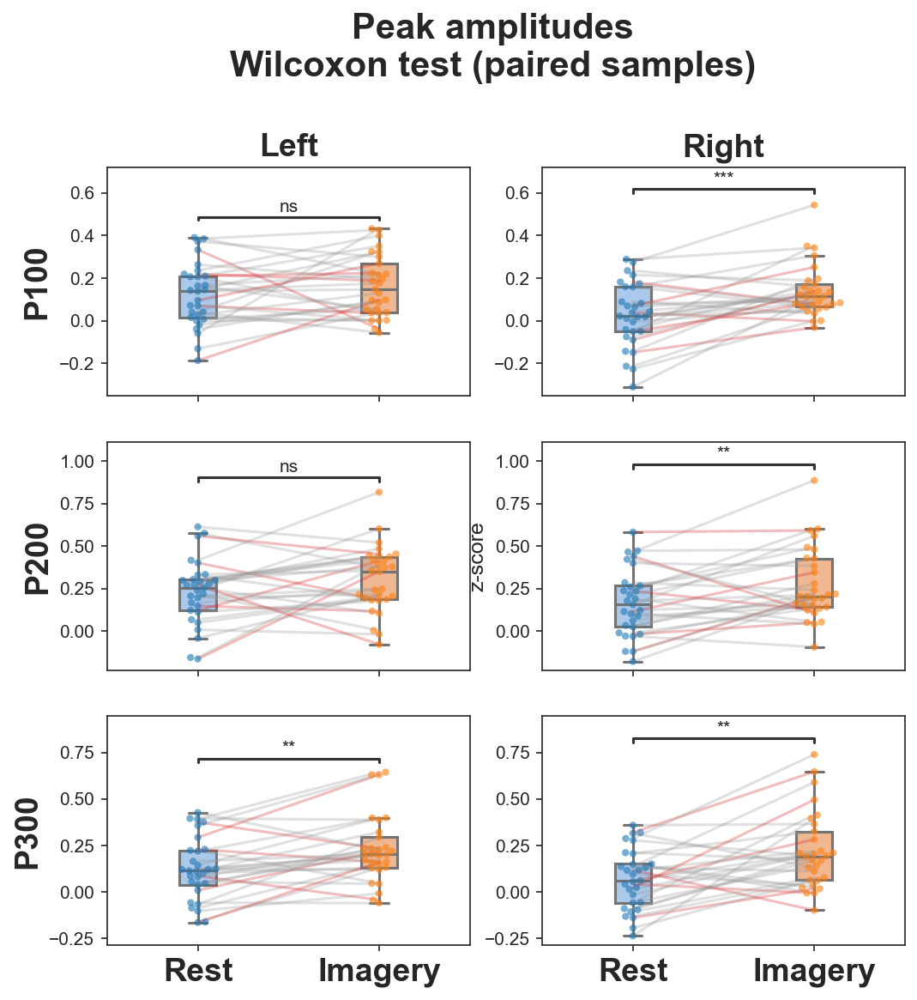

In [34]:
cond = np.array(list(np.argwhere(mu_power_learning>0)[0]) + list(np.argwhere(mu_power_imagery>0)[:, 0])) # bad_imaginers
not_cond = np.array([i for i in range(n_part) if i not in cond]) # good imaginers

fig, axes = plt.subplots(nrows=3, ncols=2, dpi=150, figsize=(8, 8), sharex=True)
f1 = 18
f2 = 20

box_pairs = [
    ('Rest', 'Imagery')
]

peaks = [
    ['P100_left', 'P100_right'],
    ['P200_left', 'P200_right'],
    ['P300_left', 'P300_right']
]

palette = np.array(["#999999"]*len(np.unique(df.id)))
palette[cond.astype(int)] = '#D62728'

all_locs = [[es_p100_left, es_p100_right], [es_p200_left, es_p200_right], [es_p300_left, es_p300_right]]

for i, ps in enumerate(peaks):
    for j, peak in enumerate(ps):
        sns.boxplot(data=df, x='condition', y=peak, showfliers=False, ax=axes[i][j], palette='pastel', width=0.2)
        g = sns.swarmplot(data=df, x='condition', y=peak, ax=axes[i][j], alpha=0.6, size=4)
        sns.lineplot(data=df, y=peak, x='condition', hue='id', sort=False, palette=sns.color_palette(palette),
                     estimator=None, legend=False, ax=axes[i][j], alpha=0.3)
        
        test_results = add_stat_annotation(g, data=df, x='condition', y=peak,
                                           box_pairs=box_pairs, comparisons_correction=None,
                                           test='Wilcoxon', text_format='star',
                                           loc='inside', verbose=2)
        axes[i][j].set_xlabel('') 
        axes[i][j].set_ylabel('')
        
#         leg = axes[i][j].legend(loc=2)
#         leg.set_title(', '.join([electrodes[i] for i in all_locs[i][j]]),prop={'size':8})
    
    axes[i][0].set_ylabel(peak[:4], fontsize=f1, fontweight='bold')
    axes[i][0].sharey(axes[i][1])

    
axes[1][1].set_ylabel('z-score', fontsize=12)
    
axes[0][0].set_title('Left', fontsize=f1, fontweight='bold')
axes[0][1].set_title('Right', fontsize=f1, fontweight='bold')

axes[-1][0].set_xticklabels(['Rest', 'Imagery'], rotation=0, weight='bold', size=f1)
axes[-1][1].set_xticklabels(['Rest', 'Imagery'], rotation=0, weight='bold', size=f1)

suptitle = plt.suptitle('Peak amplitudes\nWilcoxon test (paired samples)', fontsize=f2, fontweight='bold', y=1.03)

plt.savefig('pics/erp_stats.jpg', bbox_extra_artists=[suptitle], bbox_inches='tight')

In [35]:
def get_li(x, y):
    return (x-y)/(x+y)

In [36]:
df_peaks_li = pd.DataFrame({
    'P100_rest':get_li(df[df.condition == 'Rest'].P100_right, df[df.condition == 'Rest'].P100_left),
    'P100_imagery':get_li(df[df.condition == 'Imagery'].P100_right, df[df.condition == 'Imagery'].P100_left),
    'P200_rest':get_li(df[df.condition == 'Rest'].P200_right, df[df.condition == 'Rest'].P200_left),
    'P200_imagery':get_li(df[df.condition == 'Imagery'].P200_right, df[df.condition == 'Imagery'].P200_left),
    'P300_rest':get_li(df[df.condition == 'Rest'].P300_right, df[df.condition == 'Rest'].P300_left),
    'P300_imagery':get_li(df[df.condition == 'Imagery'].P300_right, df[df.condition == 'Imagery'].P300_left),
})

df_peaks_li.head()

,P100_rest,P100_imagery,P200_rest,P200_imagery,P300_rest,P300_imagery
0,-5.814858,-1.328788,-0.156399,-0.265886,-2.176288,-0.864689
1,-1.597968,-0.377776,-1.313538,-0.402655,-0.692330,-1.079258
2,0.074018,0.349484,-0.364890,0.863674,0.392964,-0.004860
3,-0.293190,-1.149876,-0.029043,-0.088259,0.739444,0.124462
4,-0.548793,-0.476955,-0.041667,-0.651294,24.417617,-0.641514


In [37]:
for i in df_peaks_li.columns.values:
    print(i)
    get_stat(df_peaks_li[i])
    print()

P100_rest
-0.29 [-0.73-0.41]

P100_imagery
-0.07 [-0.38-0.45]

P200_rest
-0.13 [-0.32--0.02]

P200_imagery
-0.06 [-0.19-0.13]

P300_rest
-0.08 [-0.69-0.39]

P300_imagery
-0.00 [-0.49-0.18]



In [38]:
print(stats.wilcoxon(df_peaks_li.P100_rest, df_peaks_li.P100_imagery))
print(stats.wilcoxon(df_peaks_li.P200_rest, df_peaks_li.P200_imagery))
print(stats.wilcoxon(df_peaks_li.P300_rest, df_peaks_li.P300_imagery))

WilcoxonResult(statistic=136.0, pvalue=0.07975950092077255)
WilcoxonResult(statistic=135.0, pvalue=0.07598886638879776)
WilcoxonResult(statistic=209.0, pvalue=0.8647311441600323)


# Short stimuli wavelets

In [39]:
rest_erp_w = np.load('data_for_final_pics/short_wavelets/power_rest.npy')
im_erp_w = np.load('data_for_final_pics/short_wavelets/power_im.npy')

mu_ind_values = np.genfromtxt('data_for_final_pics/long_wavelets/mu_freq.csv') # we use the same individual mu and beta frequencies
beta_ind_values = np.genfromtxt('data_for_final_pics/long_wavelets/beta_freq.csv')

times = np.linspace(-0.5, 1, 75)
freqs = np.genfromtxt('data_for_final_pics/short_wavelets/freqs.csv')

Text(0.5, 0.9, 'Sensorimotor (C3, CP3) wavelets and individual mu and beta frequencies (red)')

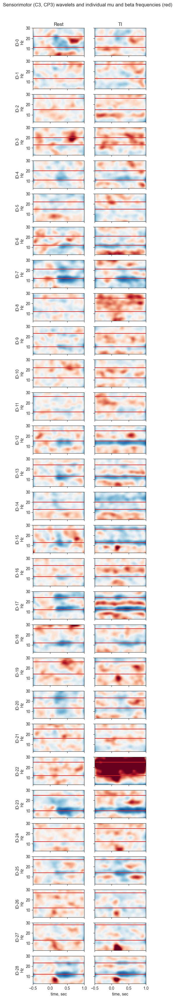

In [40]:
left_sm = [electrodes.index(i) for i in ['C3', 'CP3']]

fig, axes = plt.subplots(nrows=n_part, ncols=2, figsize=(5, n_part*1.5), dpi=100, sharex=True, sharey=True)

for i in range(n_part):
    axes[i][0].pcolormesh(times, freqs, np.mean(rest_erp_w[i, left_sm], axis=0)*100, vmin=-80, vmax=80, cmap='RdBu_r', shading='gouraud')    
    axes[i][1].pcolormesh(times, freqs, np.mean(im_erp_w[i, left_sm], axis=0)*100, vmin=-80, vmax=80, cmap='RdBu_r', shading='gouraud')
    
    for j in range(2):
        axes[i][j].axhline(mu_ind_values[i], color='tab:red')
        axes[i][j].axhline(beta_ind_values[i], color='tab:red')
    
    axes[i][0].set_ylabel('ID-'+str(i)+'\nHz')
    
axes[0][0].set_title('Rest')
axes[0][1].set_title('TI')

axes[-1][0].set_xlabel('time, sec')
axes[-1][1].set_xlabel('time, sec')

plt.suptitle('Sensorimotor (C3, CP3) wavelets and individual mu and beta frequencies (red)', y=0.9)

In [41]:
# cond = np.array(list(np.argwhere(mu_power_learning>0)[0]) + list(np.argwhere(mu_power_imagery>0)[:, 0])) # bad_imaginers
# cond = np.insert(cond, 0, 22) # very bad outlier
# not_cond = np.array([i for i in range(n_part) if i not in cond]) # good imaginers

# or
cond = np.array([22])
not_cond = np.array([i for i in range(n_part) if i not in cond]) # remove only bad outlier

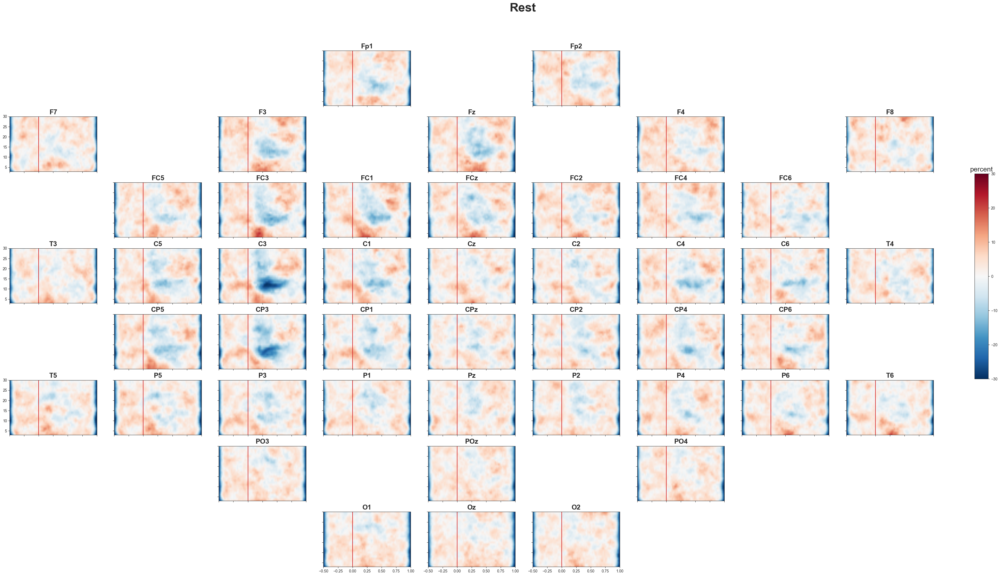

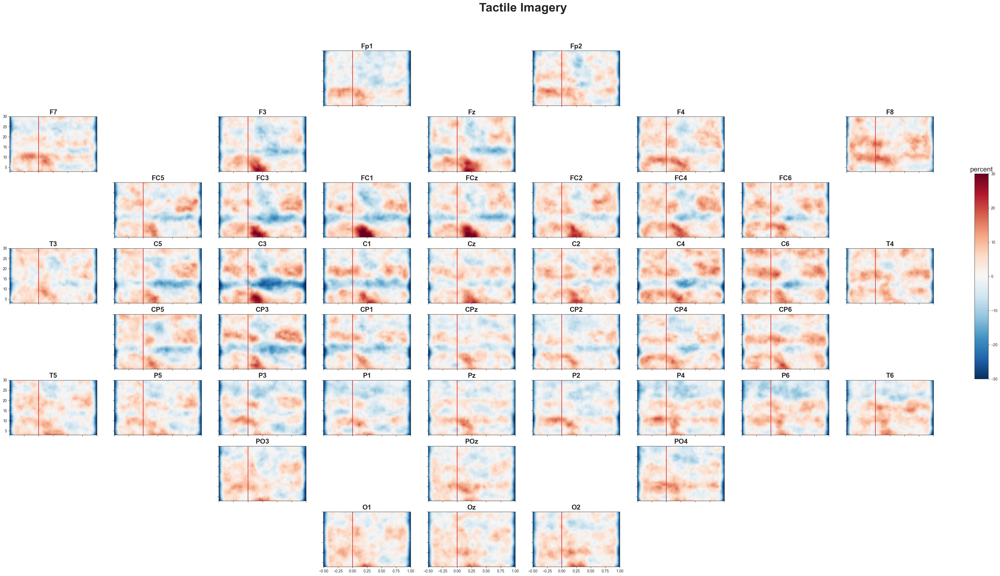

In [42]:
labels = ['Rest', 'Tactile Imagery']

vmin, vmax = -30, 30
freqs = np.arange(3, 31)
times = np.round(np.linspace(-0.5, 1, 75), 2)

for j, tfr in enumerate([rest_erp_w[not_cond], im_erp_w[not_cond]]):
    
    figure, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(50, 25), sharex=True, sharey=True, dpi=100)

    for e in range(len(electrodes)):
        if electrodes[e] in ['TP9', 'TP10']:
            continue
        cp = axes[rows_seq[e]][cols_seq[e]].pcolormesh(times, freqs, np.median(tfr[:, e], axis=0)*100, vmin=vmin, vmax=vmax, cmap='RdBu_r', shading='gouraud')
        axes[rows_seq[e]][cols_seq[e]].set_title(electrodes[e], fontsize=18, fontweight='bold')
        axes[rows_seq[e]][cols_seq[e]].axvline(0, color='tab:red')
#             axes[rows_seq[e]][cols_seq[e]].axhline(mu_f, color='tab:red')

    pairs = [str(rows_seq[i])+str(cols_seq[i]) for i in range(len(electrodes))]

    for row in range(nrows):
        for col in range(ncols):
            if str(row) + str(col) not in pairs:
                axes[row][col].set_axis_off()

    figure.subplots_adjust(right=0.8)
    cbar_ax = figure.add_axes([0.83, 0.4, 0.01, 0.3])
    cbar = figure.colorbar(cp, cax=cbar_ax)
    cbar.ax.set_title('percent', fontsize=18)

    suptitle = plt.suptitle(labels[j], fontsize=32, y=0.95, fontweight='bold')
    plt.savefig('pics/'+labels[j]+'_median_short_wavelets.jpg', bbox_extra_artists=[suptitle], bbox_inches='tight')
    plt.show()

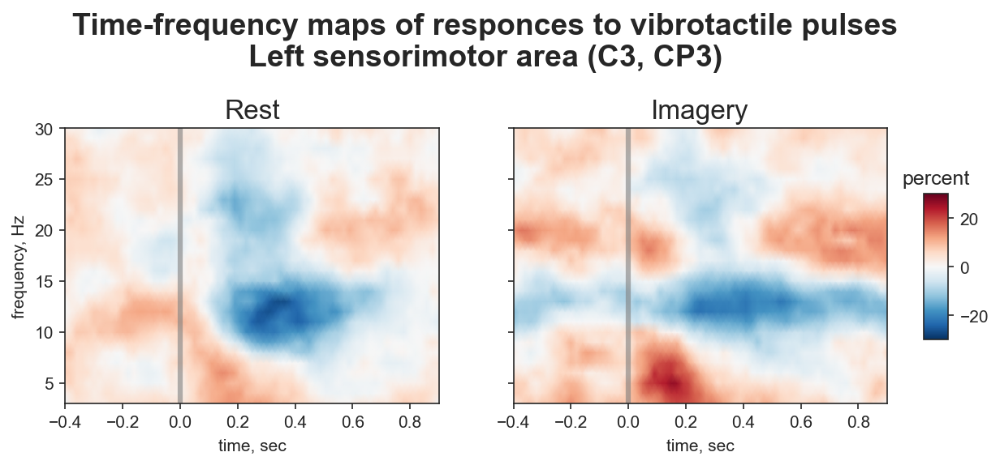

In [43]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 3), dpi=150, sharex=True, sharey=True)
labels = ['Rest', 'Imagery']

left_sm = [electrodes.index(i) for i in ['C3', 'CP3']]

f1 = 16
f2 = 20

vmin,vmax = -30, 30

freqs = np.arange(3, 31)
times = np.round(np.linspace(-0.5, 1, 75), 2)

for i, tfr in enumerate([rest_erp_w[not_cond], im_erp_w[not_cond]]):
    
    cp = axes[i].pcolormesh(times, freqs, np.median(tfr[:, left_sm, :, :], axis=(0, 1))*100, vmin=vmin, vmax=vmax, cmap='RdBu_r', shading='gouraud')
    axes[i].axvline(0, color='tab:grey', alpha=0.6, linewidth=3)
    axes[i].set_title(labels[i], fontsize=f1)

axes[0].set_ylabel('frequency, Hz')  
axes[0].set_xlabel('time, sec')
axes[1].set_xlabel('time, sec')
    
suptitle = plt.suptitle('Time-frequency maps of responces to vibrotactile pulses\nLeft sensorimotor area (C3, CP3)', fontsize=18, fontweight='bold', x=0.47, y=1.2)
    
axes[i].set_xlim(-0.4, 0.9)

fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([0.83, 0.3, 0.02, 0.4])
cbar = fig.colorbar(cp, cax=cbar_ax)
cbar.ax.set_title('percent')

plt.savefig('pics/wavelets_powers_pulses.jpg', bbox_extra_artists=[suptitle])

In [44]:
t1_theta_i, t2_theta_i = 30, 40
theta_f1 = np.where(freqs == 3)[0][0]
theta_f2 = np.where(freqs == 8)[0][0]

t1_mu_i, t2_mu_i = 30, 55
t1_beta_i, t2_beta_i = 30, 40

pulse_theta = np.zeros((2, n_part, 47))
pulse_ind_mu = np.zeros((2, n_part, 47))
pulse_ind_beta = np.zeros((2, n_part, 47))

pulse_theta[0] = np.median(rest_erp_w[:, :, theta_f1:theta_f2, t1_theta_i:t2_theta_i], axis=(-1, -2))
pulse_theta[1] = np.median(im_erp_w[:, :, theta_f1:theta_f2, t1_theta_i:t2_theta_i], axis=(-1, -2))

for i in range(n_part):
    
    fi = np.where(freqs == mu_ind_values[i])[0][0]
    mu_mean = np.median(rest_erp_w[i, :, (fi-1):(fi+2), t1_mu_i:t2_mu_i], axis=(-1, -2))
    pulse_ind_mu[0, i] = mu_mean
    mu_mean = np.median(im_erp_w[i, :, (fi-1):(fi+2), t1_mu_i:t2_mu_i], axis=(-1, -2))
    pulse_ind_mu[1, i] = mu_mean
    
    fi = np.where(freqs == beta_ind_values[i])[0][0]
    beta_mean = np.median(rest_erp_w[i, :, (fi-1):(fi+2), t1_beta_i:t2_beta_i], axis=(-1, -2))
    pulse_ind_beta[0, i] = beta_mean
    beta_mean = np.median(im_erp_w[i, :, (fi-1):(fi+2), t1_beta_i:t2_beta_i], axis=(-1, -2))
    pulse_ind_beta[1, i] = beta_mean

In [45]:
theta_roi = [electrodes.index(i) for i in ['Fz', 'F3', 'FCz', 'FC1', 'FC3']]
sm_left = [electrodes.index(i) for i in ['C5', 'C3', 'C1', 'CP5', 'CP3', 'CP1']]

In [46]:
pulse_theta = pulse_theta[:, not_cond]
pulse_ind_mu = pulse_ind_mu[:, not_cond]
pulse_ind_beta = pulse_ind_beta[:, not_cond]

<ipython-input-47-d1e34134f1ff>:38: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


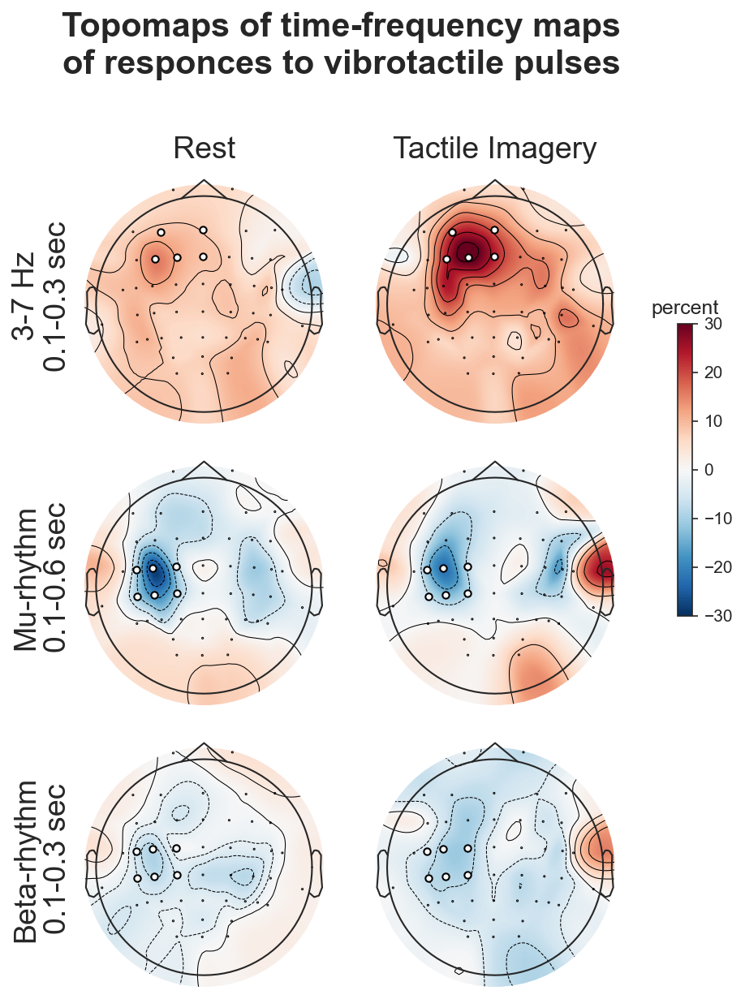

In [47]:
fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(6, 8), dpi=150)

vlim = (-30, 30)
f1, f2 = 18, 20

for i in range(2):
    average = np.median(pulse_theta[i], axis=(0))
    mne.viz.plot_topomap(average*100, info, axes=axes[0][i if i==0 else 1], vlim=vlim, cmap='RdBu_r',
                         mask=np.array([True if e in theta_roi else False for e in range(len(electrodes))]),
                         show=False)
    
for i in range(2):
    average = np.median(pulse_ind_mu[i], axis=(0))
    im, cm = mne.viz.plot_topomap(average*100, info, axes=axes[1][i if i==0 else 1], vlim=vlim, cmap='RdBu_r',
                         mask=np.array([True if e in sm_left else False for e in range(len(electrodes))]),
                         show=False)
    
for i in range(2):
    average = np.median(pulse_ind_beta[i], axis=(0))
    mne.viz.plot_topomap(average*100, info, axes=axes[2][i if i==0 else 1], vlim=vlim, cmap='RdBu_r',
                         mask=np.array([True if e in sm_left else False for e in range(len(electrodes))]),
                         show=False)
    
axes[0][0].set_title('Rest', fontsize=f1)
axes[0][1].set_title('Tactile Imagery', fontsize=f1)

axes[0][0].set_ylabel(f'3-7 Hz\n{times[t1_theta_i].round(1)}-{times[t2_theta_i].round(1)} sec', fontsize=f1)
axes[1][0].set_ylabel(f'Mu-rhythm\n{times[t1_mu_i].round(1)}-{times[t2_mu_i].round(1)} sec', fontsize=f1)
axes[2][0].set_ylabel(f'Beta-rhythm\n{times[t1_beta_i].round(1)}-{times[t2_beta_i].round(1)} sec', fontsize=f1)

fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([0.96, 0.4, 0.02, 0.3])
cbar = fig.colorbar(im, cax=cbar_ax)
cbar.ax.set_title('percent')

suptitle = plt.suptitle('Topomaps of time-frequency maps\nof responces to vibrotactile pulses', fontsize=f2, fontweight='bold', y=1.02)

plt.tight_layout()
plt.subplots_adjust(hspace=0.1, right=0.9)

plt.savefig('pics/topomaps_powers_pulses.jpg', bbox_extra_artists=[suptitle])

In [48]:
avg = np.median(pulse_theta[..., theta_roi], axis=-1)
df_theta = pd.DataFrame({
    'theta_power':list(avg.reshape(-1)),
    'condition':['rest']*pulse_theta.shape[1]+['imagery']*pulse_theta.shape[1],
    'id':list(range(pulse_theta.shape[1]))*2
})

avg = np.median(pulse_ind_mu[..., sm_left], axis=-1)
df_mu = pd.DataFrame({
    'mu_power':list(avg.reshape(-1)),
    'condition':['rest']*pulse_ind_mu.shape[1]+['imagery']*pulse_ind_mu.shape[1],
    'id':list(range(pulse_ind_mu.shape[1]))*2
})

avg = np.median(pulse_ind_beta[..., sm_left], axis=-1)
df_beta = pd.DataFrame({
    'beta_power':list(avg.reshape(-1)),
    'condition':['rest']*pulse_ind_beta.shape[1]+['imagery']*pulse_ind_beta.shape[1],
    'id':list(range(pulse_ind_beta.shape[1]))*2
})

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

Using zero_method  wilcox
rest v.s. imagery: Wilcoxon test (paired samples), P_val=1.289e-03 stat=6.700e+01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

Using zero_method  wilcox
rest v.s. imagery: Wilcoxon test (paired samples), P_val=5.519e-01 stat=1.760e+02
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

Using zero_method  wilcox
rest v.s. imagery: Wilcoxon test (paired samples), P_val=9.553e-01 stat=2.000e+02


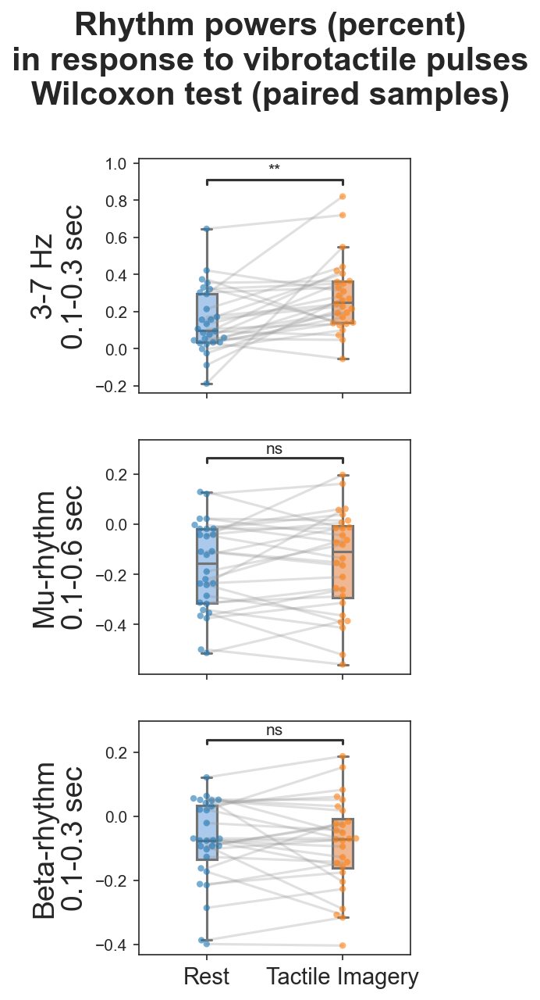

In [49]:
box_pairs = [
    ('rest', 'imagery')
]

fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(3, 9), dpi=150, sharex=True)

sns.boxplot(data=df_theta, x='condition', y='theta_power', showfliers=False, palette='pastel', ax=axes[0], width=0.15)
g = sns.swarmplot(data=df_theta, x='condition', y='theta_power', alpha=0.6, ax=axes[0], size=4)
sns.lineplot(data=df_theta, y='theta_power', x='condition', hue='id', sort=False, palette=sns.color_palette(["#999999"]*len(np.unique(df_theta.id))),
             estimator=None, legend=False, ax=axes[0], alpha=0.3)

test_results = add_stat_annotation(g, data=df_theta, x='condition', y='theta_power',
                                   box_pairs=box_pairs, comparisons_correction=None,
                                   test='Wilcoxon', text_format='star',
                                   loc='inside', verbose=2)

sns.boxplot(data=df_mu, x='condition', y='mu_power', showfliers=False, palette='pastel', ax=axes[1], width=0.15)
g = sns.swarmplot(data=df_mu, x='condition', y='mu_power', alpha=0.6, ax=axes[1], size=4)
sns.lineplot(data=df_mu, y='mu_power', x='condition', hue='id', sort=False, palette=sns.color_palette(["#999999"]*len(np.unique(df_theta.id))),
             estimator=None, legend=False, ax=axes[1], alpha=0.3)

test_results = add_stat_annotation(g, data=df_mu, x='condition', y='mu_power',
                                   box_pairs=box_pairs, comparisons_correction=None,
                                   test='Wilcoxon', text_format='star',
                                   loc='inside', verbose=2)

sns.boxplot(data=df_beta, x='condition', y='beta_power', showfliers=False, palette='pastel', ax=axes[2], width=0.15)
g = sns.swarmplot(data=df_beta, x='condition', y='beta_power', alpha=0.6, ax=axes[2], size=4)
sns.lineplot(data=df_beta, y='beta_power', x='condition', hue='id', sort=False, palette=sns.color_palette(["#999999"]*len(np.unique(df_theta.id))),
             estimator=None, legend=False, ax=axes[2], alpha=0.3)

test_results = add_stat_annotation(g, data=df_beta, x='condition', y='beta_power',
                                   box_pairs=box_pairs, comparisons_correction=None,
                                   test='Wilcoxon', text_format='star',
                                   loc='inside', verbose=2)

axes[0].set_ylabel(f'3-7 Hz\n{times[t1_theta_i].round(1)}-{times[t2_theta_i].round(1)} sec', fontsize=f1)
axes[1].set_ylabel(f'Mu-rhythm\n{times[t1_mu_i].round(1)}-{times[t2_mu_i].round(1)} sec', fontsize=f1)
axes[2].set_ylabel(f'Beta-rhythm\n{times[t1_beta_i].round(1)}-{times[t2_beta_i].round(1)} sec', fontsize=f1)

# plt.xticks(['rest', 'im_im'], ['Rest', 'Imagery'])
axes[0].set_xlabel('')
axes[1].set_xlabel('')
axes[2].set_xlabel('')

axes[-1].set_xticklabels(['Rest', 'Tactile Imagery'], rotation=0, size=14)

# leg = axes[0].legend(loc=2)
# leg.set_title('Fz, F3\nFCz, FC1, FC3',prop={'size':8})

# leg = axes[1].legend(loc=2)
# leg.set_title('C5, C3, C1\nCP5, CP3, CP1',prop={'size':8})

# leg = axes[2].legend(loc=2)
# leg.set_title('C5, C3, C1\nCP5, CP3, CP1',prop={'size':8})

suptitle = plt.suptitle('Rhythm powers (percent)\nin response to vibrotactile pulses\nWilcoxon test (paired samples)', fontsize=f2, y=1.02, fontweight='bold')
plt.savefig('pics/boxplots_powers_pulses.jpg', bbox_extra_artists=[suptitle], bbox_inches='tight')